## Let's start

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from matplotlib import pyplot as plt
import seaborn as sns
pd.set_option('float_format', '{:.2f}'.format)
import warnings
warnings.filterwarnings('ignore')

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/kaggle/input/youtube-trending-video-dataset/MX_youtube_trending_data.csv
/kaggle/input/youtube-trending-video-dataset/GB_youtube_trending_data.csv
/kaggle/input/youtube-trending-video-dataset/BR_category_id.json
/kaggle/input/youtube-trending-video-dataset/FR_youtube_trending_data.csv
/kaggle/input/youtube-trending-video-dataset/IN_youtube_trending_data.csv
/kaggle/input/youtube-trending-video-dataset/MX_category_id.json
/kaggle/input/youtube-trending-video-dataset/GB_category_id.json
/kaggle/input/youtube-trending-video-dataset/US_category_id.json
/kaggle/input/youtube-trending-video-dataset/BR_youtube_trending_data.csv
/kaggle/input/youtube-trending-video-dataset/RU_youtube_trending_data.csv
/kaggle/input/youtube-trending-video-dataset/IN_category_id.json
/kaggle/input/youtube-trending-video-dataset/KR_category_id.json
/kaggle/input/youtube-trending-video-dataset/DE_youtube_trending_data.csv
/kaggle/input/youtube-trending-video-dataset/RU_category_id.json
/kaggle/input/youtube-trend

In [2]:
# Load our data
trending= pd.read_csv('../input/youtube-trending-video-dataset/IN_youtube_trending_data.csv')

In [3]:
# Number of columns and rows
trending.shape

(89382, 16)

In [4]:
# Let's view the first 5 rows
trending.head(5)

,video_id,title,publishedAt,channelId,channelTitle,categoryId,trending_date,tags,view_count,likes,dislikes,comment_count,thumbnail_link,comments_disabled,ratings_disabled,description
0,Iot0eF6EoNA,Sadak 2 | Official Trailer | Sanjay | Pooja | ...,2020-08-12T04:31:41Z,UCGqvJPRcv7aVFun-eTsatcA,FoxStarHindi,24,2020-08-12T00:00:00Z,sadak|sadak 2|mahesh bhatt|vishesh films|pooja...,9885899,224925,3979409,350210,https://i.ytimg.com/vi/Iot0eF6EoNA/default.jpg,False,False,Three Streams. Three Stories. One Journey. Sta...
1,x-KbnJ9fvJc,Kya Baat Aa : Karan Aujla (Official Video) Tan...,2020-08-11T09:00:11Z,UCm9SZAl03Rev9sFwloCdz1g,Rehaan Records,10,2020-08-12T00:00:00Z,[None],11308046,655450,33242,405146,https://i.ytimg.com/vi/x-KbnJ9fvJc/default.jpg,False,False,Singer/Lyrics: Karan Aujla Feat Tania Music/ D...
2,KX06ksuS6Xo,Diljit Dosanjh: CLASH (Official) Music Video |...,2020-08-11T07:30:02Z,UCZRdNleCgW-BGUJf-bbjzQg,Diljit Dosanjh,10,2020-08-12T00:00:00Z,clash diljit dosanjh|diljit dosanjh|diljit dos...,9140911,296533,6179,30058,https://i.ytimg.com/vi/KX06ksuS6Xo/default.jpg,False,False,CLASH official music video performed by DILJIT...
3,UsMRgnTcchY,Dil Ko Maine Di Kasam Video | Amaal M Ft.Ariji...,2020-08-10T05:30:49Z,UCq-Fj5jknLsUf-MWSy4_brA,T-Series,10,2020-08-12T00:00:00Z,hindi songs|2020 hindi songs|2020 new songs|t-...,23564512,743931,84162,136942,https://i.ytimg.com/vi/UsMRgnTcchY/default.jpg,False,False,Gulshan Kumar and T-Series presents Bhushan Ku...
4,WNSEXJJhKTU,"Baarish (Official Video) Payal Dev,Stebin Ben ...",2020-08-11T05:30:13Z,UCye6Oz0mg46S362LwARGVcA,VYRLOriginals,10,2020-08-12T00:00:00Z,VYRL Original|Mohsin Khan|Shivangi Joshi|Payal...,6783649,268817,8798,22984,https://i.ytimg.com/vi/WNSEXJJhKTU/default.jpg,False,False,VYRL Originals brings to you ‘Baarish’ - the b...


### Category ID
https://techpostplus.com/youtube-video-categories-list-faqs-and-solutions/

In [5]:
# How many unique channels do we have in this dataset?
trending['channelTitle'].nunique()

2828

In this dataset, there are 2264 channels.

In [6]:
# Check for Null values
trending.isna().sum()

video_id                0
title                   0
publishedAt             0
channelId               0
channelTitle            1
categoryId              0
trending_date           0
tags                    0
view_count              0
likes                   0
dislikes                0
comment_count           0
thumbnail_link          0
comments_disabled       0
ratings_disabled        0
description          3014
dtype: int64

There 245 missing description values

In [7]:
# Imputing data. There are many ways to fill the missing data. For example filling the NAs with the most frequent value, 
# random values, etc.
trending.description= trending.description.fillna('No description provided')

In [8]:
# Make sure thre is no null data(We're good to go)
trending.isna().sum().sum()

1

# Statistics for numerical & non-numerical columns

In [9]:
trending.describe()

,categoryId,view_count,likes,dislikes,comment_count
count,89382.00,89382.00,89382.00,89382.00,89382.00
mean,20.70,2999885.32,149957.87,6340.98,13006.98
std,6.22,7878386.45,458792.12,120588.66,107705.01
min,1.00,0.00,0.00,0.00,0.00
25%,20.00,418804.25,14850.00,526.00,612.00
50%,24.00,998043.00,40683.50,1379.00,1860.00
75%,24.00,2480777.25,114517.25,3765.75,6140.00
max,29.00,264407389.00,16115240.00,12341474.00,6738565.00


In [10]:
# stats for non-numerical columns
trending.describe(include = ['O'])

,video_id,title,publishedAt,channelId,channelTitle,trending_date,tags,thumbnail_link,description
count,89382,89382,89382,89382,89381,89382,89382,89382,89382
unique,25815,26197,25541,2762,2828,455,17566,25816,23973
top,y_RHQ4mBDKA,Kundali Bhagya | कुंडली भाग्य | Monday - Frida...,2021-06-04T18:15:01Z,UCvrhwpnp2DHYQ1CbXby9ypQ,Vijay Television,2021-03-02T00:00:00Z,[None],https://i.ytimg.com/vi/y_RHQ4mBDKA/default.jpg,No description provided
freq,19,37,20,1284,1284,398,11342,19,3014


In [11]:
# Ratio of videos published by year
trending["publishedAt"].apply(lambda x: x[:4]).value_counts(normalize=True)

2021   0.70
2020   0.30
Name: publishedAt, dtype: float64

In [12]:
# Ratio of videos with comments disabled and enabled
trending["comments_disabled"].value_counts(normalize=True)

False   0.99
True    0.01
Name: comments_disabled, dtype: float64

In [13]:
# Ratio of videos with ratings disabled and enabled
trending["ratings_disabled"].value_counts(normalize=True)

False   0.99
True    0.01
Name: ratings_disabled, dtype: float64

# Correlation Matrix

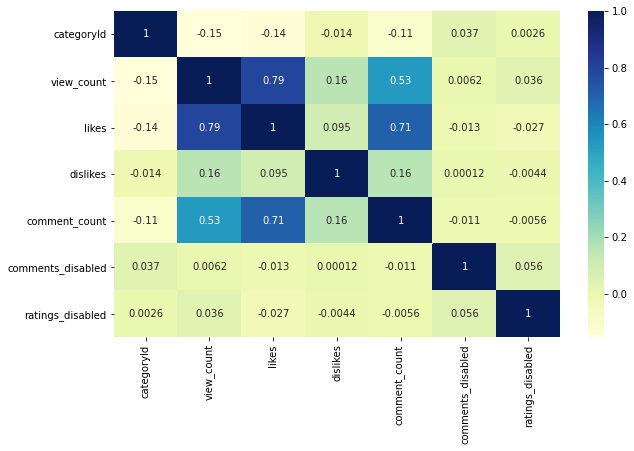

In [14]:
figure = plt.subplots(figsize=(10,6))
corr_map = sns.heatmap(trending.corr(), annot=True, cmap="YlGnBu")

# Top 10 Channels having highest trending video

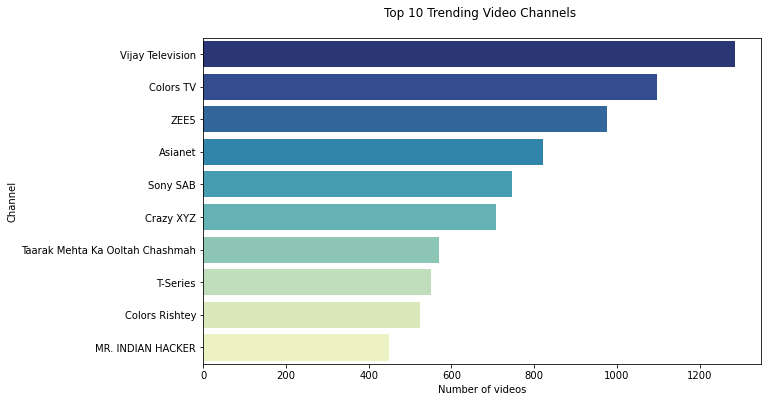

In [15]:
# Top 10 Channels having highest trending videos

videos_by_channel = trending.groupby("channelTitle").size().reset_index(name="no_of_videos") \
    .sort_values("no_of_videos", ascending=False).head(10)
fig, ax = plt.subplots(figsize=(10,6))
vbc_plot = sns.barplot(x="no_of_videos", y="channelTitle", data=videos_by_channel, palette="YlGnBu_r")
vbc_plot = ax.set(xlabel="Number of videos", ylabel="Channel")
plt.title("Top 10 Trending Video Channels \n")
plt.show()

# Top 10 Categories having highest trending videos

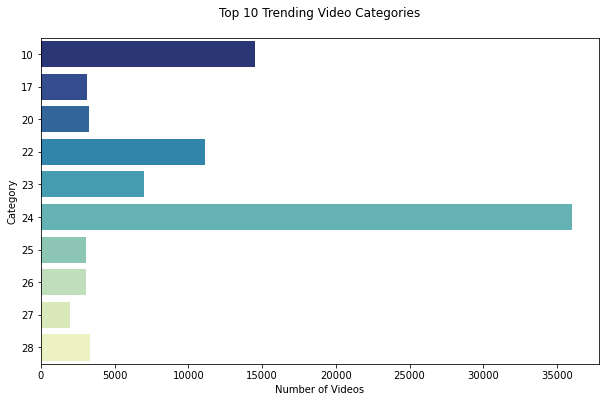

In [16]:
# Top 10 Categories having highest trending videos
# category names are not available in dataset 

videos_by_category = trending.groupby("categoryId").size().reset_index(name="no_of_videos") \
    .sort_values("no_of_videos", ascending=False).head(10)
fig, ax = plt.subplots(figsize=(10,6))
vbcat_plot = sns.barplot(x="no_of_videos", y="categoryId", data=videos_by_category, palette="YlGnBu_r", orient = 'h')
vbcat_plot = ax.set(xlabel="Number of Videos", ylabel="Category")
plt.title("Top 10 Trending Video Categories\n")
plt.show()

# Top 10 Trending videos in the category having highest trending videos

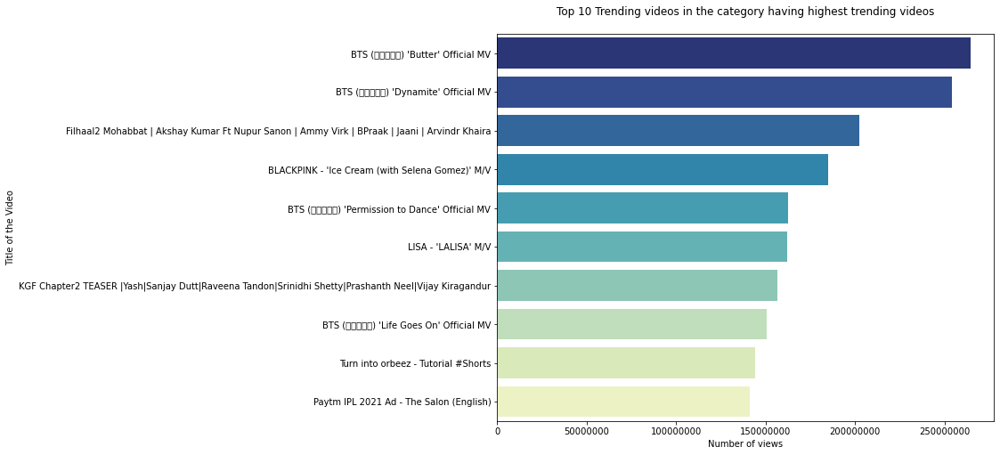

In [17]:
# From the previous plot, it seems that category 10 hosted the highest number of trending videos
category10_videos = trending[["title","view_count"]].sort_values(by="view_count",ascending=False).drop_duplicates("title",keep="first")
category10_top10 = category10_videos.nlargest(10, ["view_count"])

fig, ax = plt.subplots(figsize=(10,8))
top10_plot = sns.barplot(data=category10_top10, x='view_count', y='title', palette="YlGnBu_r", ax=ax, ci=None)
top10_plot = ax.set(xlabel="Number of views", ylabel="Title of the Video")
plt.ticklabel_format(axis="x", style="plain")
plt.title("Top 10 Trending videos in the category having highest trending videos\n")
plt.show()

# Impact of video published hour on trending videos

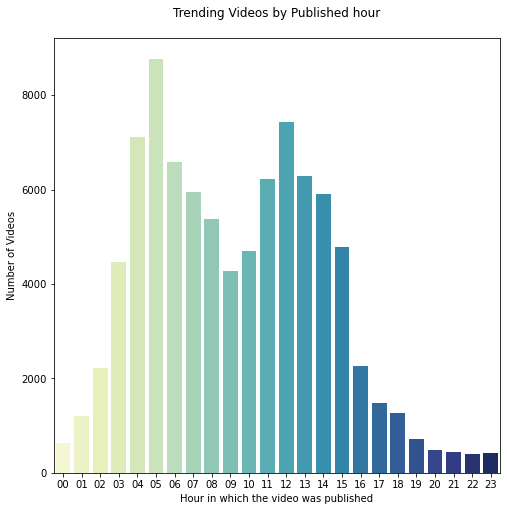

In [18]:
# extract published hour from the publishedAt 
trending["publish_hour"] = trending["publishedAt"].apply(lambda x: x[11:13])

# plot no of videos published by hour 
videos_by_pub_hour = trending.groupby("publish_hour").size().reset_index(name="no_of_videos")
    
fig, ax = plt.subplots(figsize=(8,8))
vph_plot = sns.barplot(x="publish_hour", y="no_of_videos", data=videos_by_pub_hour,palette="YlGnBu")
vph_plot = ax.set(xlabel="Hour in which the video was published", ylabel="Number of Videos")
plt.title("Trending Videos by Published hour\n")
plt.show()

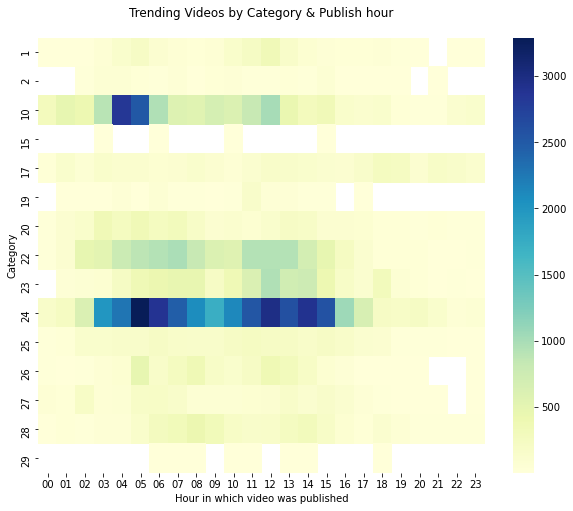

In [19]:
# plot videos published by hour and category
videos_by_cat_pub_hour = trending.groupby(["categoryId","publish_hour"]).count()["video_id"].unstack()

fig, ax = plt.subplots(figsize=(10,8))
vcph_plot = sns.heatmap(videos_by_cat_pub_hour, cmap="YlGnBu")
vcph_plot = ax.set(xlabel="Hour in which video was published", ylabel="Category")
plt.title("Trending Videos by Category & Publish hour\n")
plt.show()

## Analyze views, likes, dislikes

Text(0.5, 1.0, 'Regression plot for views and likes')

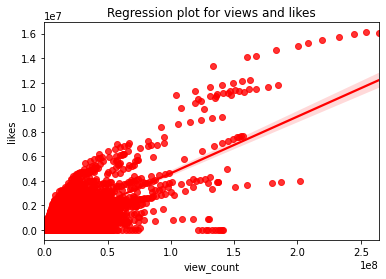

In [20]:
# Let's do a regression plot to see the relarionship between views and likes
sns.regplot(data=trending, x='view_count', y='likes', color='Red')
plt.title('Regression plot for views and likes')

This plot is showing a linear relationship between views and likes.

Text(0.5, 1.0, 'Regression plot for views and dislikes')

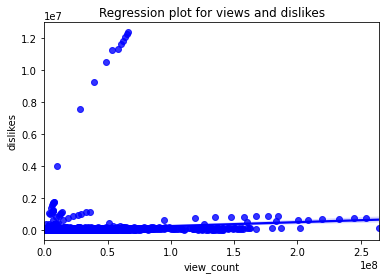

In [21]:
# Let's perform a regression plot to see the relarionship between views and dislikes
sns.regplot(data=trending, x='view_count', y='dislikes', color= 'blue')
plt.title('Regression plot for views and dislikes')

Compared to the first plot, the dislikes increase as the views increase, but not as much as the first plot. Notice the steeper line in the first graph.

In [22]:
# Let's view our correlation table:likes, dislikes, views, and comments
df_corr= trending[['likes', 'dislikes', 'comment_count', 'view_count']]
df_corr.corr()

,likes,dislikes,comment_count,view_count
likes,1.00,0.10,0.71,0.79
dislikes,0.10,1.00,0.16,0.16
comment_count,0.71,0.16,1.00,0.53
view_count,0.79,0.16,0.53,1.00


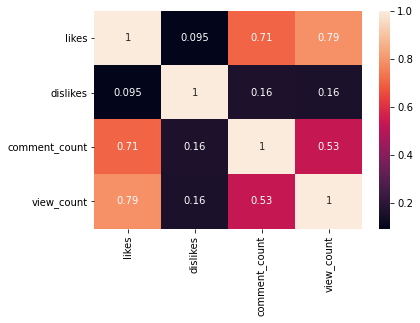

In [23]:
sns.heatmap(df_corr.corr(), annot= True)

Notice a high correlation between views and likes. That makes sense!
people who like a video tend to leave a comment and vice versa. Howver people who dislike tend not to leave a comment or vice versa.

In [24]:
# What are the video titles with most likes count
trending[['title', 'likes']].groupby('title').sum().sort_values(by= 'likes', ascending= False).head(5)

,likes
title,
BTS (방탄소년단) 'Dynamite' Official MV,139247236
BTS (방탄소년단) 'Permission to Dance' Official MV,94008261
BLACKPINK - 'Ice Cream (with Selena Gomez)' M/V,91800242
BTS (방탄소년단) 'Life Goes On' Official MV,78747652
KGF Chapter2 TEASER |Yash|Sanjay Dutt|Raveena Tandon|Srinidhi Shetty|Prashanth Neel|Vijay Kiragandur,75880519


In [25]:
# What are the video titles with most dislikes count
trending[['title', 'dislikes']].groupby('title').sum().sort_values(by= 'dislikes', ascending= False).head(5)

,dislikes
title,
Sadak 2 | Official Trailer | Sanjay | Pooja | Alia | Aditya | Jisshu | Mahesh Bhatt | 28 Aug,113912935
Khaali Peeli | Teaser | Ishaan | Ananya Panday | Maqbool Khan | Coming Soon,11146126
Chocolate - Tony Kakkar ft. Riyaz Aly & Avneet Kaur | Satti Dhillon | Anshul Garg,7144754
BLACKPINK - 'Ice Cream (with Selena Gomez)' M/V,6739622
BTS (방탄소년단) 'Dynamite' Official MV,5763604


In [26]:
# What are the video titles with most comments count
trending[['title', 'comment_count']].groupby('title').sum().sort_values(by= 'comment_count',ascending= False ).head(5)

,comment_count
title,
BTS (방탄소년단) 'Dynamite' Official MV,54101978
BTS (방탄소년단) 'Life Goes On' Official MV,30045984
EXO 엑소 'Don't fight the feeling' MV,27054550
GAME (Full Video) Shooter Kahlon | Sidhu Moose Wala | Hunny PK Films | Gold Media | 5911 Records,26626482
BLACKPINK - 'Ice Cream (with Selena Gomez)' M/V,23191280


## Sentiment Analysis**

#### Analyze trending tags

In [27]:
# Display tags
trending.tags.head(10)

0    sadak|sadak 2|mahesh bhatt|vishesh films|pooja...
1                                               [None]
2    clash diljit dosanjh|diljit dosanjh|diljit dos...
3    hindi songs|2020 hindi songs|2020 new songs|t-...
4    VYRL Original|Mohsin Khan|Shivangi Joshi|Payal...
5    haircut mythpat|haircut vlog funny|mythpat fun...
6    Paapi Munda|Mankirt Aulakh|Mankirt Aulakh Paap...
7    Naagin 5|Naagin|Season 5|Hina Khan|Dheeraj Dho...
8    funny video|ludo video|funny ludo|ludo players...
9    kambi|jatti jaandi|mahi sharma|kambi new song|...
Name: tags, dtype: object

In [28]:
# Let's join tags to get all lines in just one string.
tags_complete=''.join(trending.tags)

In [29]:
# Display tags as one string
# Rub this to see the result: tags_complete

### As you can see, we got some special charachters in our text. Ex: |, so the next step is to remove the special characters to end up with clean looking data

In [30]:
# Let's import regular expression module
import re

In [31]:
# Now we have to substitue any special character by a space.
tags= re.sub('[^a-zA-Z]', ' ', tags_complete)

In [32]:
# Display tags
tags

'sadak sadak   mahesh bhatt vishesh films pooja bhatt alia bhatt sanjay dutt aditya roy kapur alia bhatt movies alia bhatt new movies aditya roy kapur new movies aditya roy kapur movies sanjay dutt sadak   sanjay dutt sadak sanjay dutt new movies fox star studios fox star hindi disney plus hotstar disney plus movie bollywood cinema movie hindi cinema upcoming bollywood movie love story action thriller suspense None clash diljit dosanjh diljit dosanjh diljit dosanjh goat album diljit dosanjh new album punjabi songs      punjabi new song new song      goat diljit dosanjh the kidd punjabi music the kidd music raj ranjodh songs goat diljit dosanjh full album diljit dosanjh karan aujla song Diljit dosanjh new songs diljit dosanjh songs goat diljit dosanjh      goat      latest punjabi songs      punajbi      latest songs punjabi songs punjabi new songs punjabi clashhindi songs      hindi songs      new songs t series tseries tseries songs new song hit songs           songs hindi      songs 

### Notice in the last result, we ended up with extra space, let's ask Python:'Hey Python, whenever you find extra space make it one space only. Thank you!'

In [33]:
tags= re.sub(' +', ' ', tags)

In [34]:
# If you haven't installed wordcloud, please do so before you import the modules
from wordcloud import WordCloud, STOPWORDS

In [35]:
# Stopwords are a set of words that we do not need to take in consideration in ou analysis. For example, 
# He, She, they.....
wordcloud= WordCloud(width= 2000, height= 1000, stopwords= set(STOPWORDS)).generate(tags)

(-0.5, 1999.5, 999.5, -0.5)

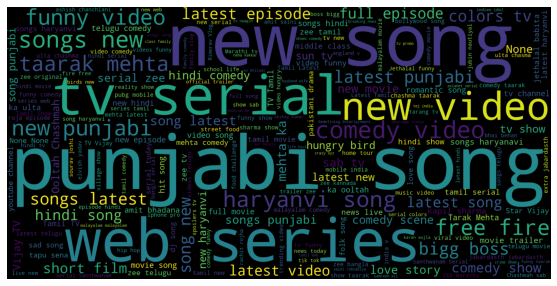

In [36]:
# Visualize our word cloud
plt.figure(figsize=(15,5))
plt.imshow(wordcloud)
plt.axis('off')

The size of the wordcloud indiacates the significance of the tag.

## Emoji Analysis

In [37]:
# Install Emoji library.
#!pip install emoji

In [38]:
# Import module emoji
import emoji

Keep in mind that each emoji has a unicode

In [39]:
# Let's define a string "str." We are creating a list for the emojis (if a character has a unicode then it will
# be considered an emoji)
str=''
for i in trending.title:
    list=[c for c in i if c in emoji.UNICODE_EMOJI]
    for ele in list:
        str= str+ele

In [40]:
# How many emojis do we have in our dataset?
len(str)

19221

In [41]:
# This is how our str looks like
str

'🔥❤🥴🔥😱💏😂🔥😂🔥🔥🔥🥴🔥❤💏😂🔥😱🏡😂🔥🔥🔥💥😂💏💥💥😱🏡🔥😂💥😂💥💥💏😱🏡🔥🤕🥴💥🔥😂😱💥💥😍🤗💏🤕🥴💥🔥💔💔💔🔥😂😱💥💥🔥🔥🔥🤕🥴💥🔥💔💔💔🔥😍😍🔥🔥🔥🤕🥴💥💔💔💔🔥🔥😍🔥😍😍😍🔥🔥🔥🔥🔥🔥🤕🥴😍🔥😍🔥😱💥😍😍🥶🥶🤩🤩🔥🔥🔥😍🇨🇭😍🔥😱😍🔥\U0001fa82\U0001fa82\U0001fa82💥😍😍🥶🥶🤩🤩🔥🔥🔥😍😍😨❤🇨🇭😍🔥😱\U0001fa82\U0001fa82\U0001fa82😍🔥🇮🇳💥😍😍🤩🤩🔥🔥🔥🤩🤪🤪😂😂😂😨❤😍🇨🇭😮😡😋😋🤩😍🔥😱💕💕\U0001fa82\U0001fa82\U0001fa82🇮🇳😍🔥😂😂😂🤩🤪🤪😨❤😍😭😱🇨🇭🏡🔥😡🔥🔥🔥😋😋🤩😱💕💕\U0001fa82\U0001fa82\U0001fa82😂😂😂🔥🔥🔥⚡⚡®🔥🔥🔥🔥🔥🔥🤩🤪🤪😨❤😍🏡🇨🇭🔥😭😱😡😱🔥®🔥🔥🔥⚡⚡😂😂😂🔥🔥🔥🔥🔥🔥😡🤩🤪🤪😨❤😍🔥😱🔥😎💥🔥🔥🔥®🔥🔥🔥⚡⚡😂😂😂🔥🔥🔥😐😟😱🔥🔥🔥🔥💥®🔥🔥🔥🤣🔊🏆😐😟😱🔥🔥🔥🔥🌸🤣🤣🤣🤩🔥🔥🔥🌹🌸🌺🤣❤🔊😭😐😟😱🔥🌸😳🔥🔥🔥🔥🔥🤣🤣🤣🤩🌹🌸🌺🔥🔥🔥🔊😭🔥🔥🔥🌸😶😳🔥🔥😘😃⚡⚡⚡🔥🔥🔥🔥🔥🔥🔥🔥🔥🌹🌸🌺🤣🤣🤣🤩🤣🔥🔥🔥⚡⚡⚡🔥🔥🔥⚡⚡⚡🌸💥🤙😶😳🔥🔥😘😃🔥🔥🔥🤣🌹🌸🌺🔥🔥🔥🔥🔥🔥⚡⚡⚡⚡⚡⚡💥🤙🌸⚡⚡⚡😶😳🔥🔥😘😃🔥🔥🔥⚡⚡⚡🔥🔥🔥⚡⚡⚡🔥🔥🔥💥🤙⚡⚡⚡🌸😶😳🔥🔥🔥🔥🔥😍🤪🌻⚡⚡⚡🔥🔥🔥⚡⚡⚡😱😱😳😫🔥🔥🔥🔥🔥🔥💥🤙🔥🔥🔥😀😀😎🔥🌻🐍🏃🔥🔥🔥😍🤪😱😃⚡⚡⚡🔥🔥🔥🔥🤮🔥🔥🔥⚡⚡⚡😱😱😳😫🤣🤷♀🤦♂😍🔥🔥🔥🔥🔥🔥💡🤔🐍🏃🌻❤🛑🔥🔥🔥😍🤪😎🔥😋👉😱😃🔥🔥🔥⚡⚡⚡🔥🤮😀😀👌👌🔥🔥🔥⚡⚡⚡😱😱😳😫🤣🤷♀🤦♂😍🔥🔥🔥🤑💡🤔🐍🏃🌻❤❤🔥🔥🔥😋👉😍🤪😱😃😎🔥🔥🔥🔥😀🛑🤯😀😀🔥🔥🔥😎⚡⚡⚡🔥🤮🔥🔥🔥😀🤑💡🔥🔥🔥⚡⚡⚡❤🤔🤯😂😂❤🐍🏃❤🌻❤🔥🔥🔥😎😭😋👉🔥🔥🔥🔥🔥🔥😀😍🤪😱😃😭🔥🔥🔥😀🤑🔥🔥🔥⚡⚡⚡💡😂😂❤🤔🤯❤🐍🏃❤❤🌻😎😭😋👉🔥🔥🔥😀🔥🔥🔥🔥🔥🔥🔥🔥🔥😂😂🔥🔥🔥⚡⚡⚡🤑❤💡💕💕🤯🤔😀🐍🏃❤❤❤🔥🔥⚡⚡⚡😍😍🔥🔥🔥😂😂🔥🔥🔥⚡⚡⚡🤑❤💡💕💕❤🤔❤🙏😊😂😂😍😍🔥🔥⚡⚡⚡📹🔥🔥🔥🔥🔥🔥🥥😳🔥🔥🔥🤑📷📷👶❤😂😂🤩🤩😍😍🔥🔥🔥🔥🔥⚡⚡⚡📹🥥😳🔥🔥🔥👙🕺💃😱😂📕🥴🤑📷📷😅🔋⚡⚡⚡👶😂😂❤🤩🤩😒😂📕🥴🥥😳🔥🔥🔥👙🕺💃🤑📷📷😅🙈😱🔋⚡⚡⚡😂😂❤🍞🎂🍞🎂😍🐍🐍🔥🔥🤣🤣😒🌶🥵😂📕🥴🔥🔥🔥🥥😳🔥🔥🔥🙈🕺💃🤑📷📷🍞🎂🍞🎂🐍🐍🔥🔥🤣🤣😍😒🌶🥵🔥🔥🌤🌻😂📕🥴🔥

In [42]:
# Let's count the unique emojis
result={}
for i in set(str):
    result[i]= str.count(i)

In [43]:
result.items()

dict_items([('🤰', 58), ('🏡', 64), ('🚫', 4), ('🕉', 17), ('👽', 11), ('🎓', 5), ('🤵', 4), ('🚐', 6), ('🍭', 11), ('🏋', 15), ('🎸', 2), ('\U0001fa82', 26), ('🏆', 46), ('🍔', 10), ('✏', 5), ('👵', 1), ('💄', 14), ('💅', 5), ('🕺', 29), ('🧸', 8), ('👎', 3), ('😅', 116), ('🇷', 21), ('🦋', 5), ('✌', 29), ('💁', 2), ('😷', 15), ('🦰', 2), ('😲', 276), ('😪', 5), ('🐍', 23), ('🔱', 2), ('💊', 5), ('🎰', 5), ('😀', 58), ('📷', 8), ('🤫', 7), ('🥁', 3), ('👶', 38), ('🥇', 14), ('👌', 102), ('🛍', 5), ('😵', 48), ('🤱', 10), ('📕', 4), ('🤭', 56), ('🌟', 23), ('🍕', 16), ('\U0001f90d', 9), ('😞', 13), ('🧱', 2), ('👹', 3), ('😚', 4), ('🐜', 2), ('🏛', 4), ('🍋', 3), ('🏄', 3), ('💃', 61), ('🇨', 16), ('🔴', 76), ('⚡', 377), ('🇸', 114), ('😈', 56), ('🥰', 265), ('🇧', 1), ('🚲', 1), ('🧗', 1), ('🐠', 4), ('🐒', 4), ('☺', 30), ('📙', 3), ('🐕', 1), ('👆', 10), ('🕯', 7), ('🎮', 9), ('🏚', 4), ('🦷', 3), ('👫', 23), ('🦁', 21), ('😍', 1214), ('🚄', 2), ('🐶', 10), ('🔋', 2), ('⬇', 3), ('👦', 16), ('😓', 17), ('🌍', 4), ('🇳', 227), ('🍤', 2), ('🏠', 87), ('🤤', 53), ('🥵', 

In [44]:
# I will define a dictionary final that has each imoji(key) and its count(value)
final={}
for key, value in sorted(result.items(), key= lambda item:item[1], reverse=True):
    final[key]= value

In [45]:
# Display our final result
final

{'🔥': 2539,
 '😂': 1368,
 '😍': 1214,
 '❤': 1103,
 '😱': 708,
 '🤣': 691,
 '😭': 440,
 '⚡': 377,
 '🙏': 363,
 '🤩': 336,
 '😲': 276,
 '🥰': 265,
 '😳': 264,
 '🇳': 227,
 '🏻': 227,
 '🥺': 222,
 '🇮': 211,
 '😜': 204,
 '😋': 190,
 '🤔': 162,
 '😎': 147,
 '♥': 143,
 '💥': 141,
 '🤑': 140,
 '🤯': 137,
 '🙈': 129,
 '🇺': 119,
 '😅': 116,
 '🇸': 114,
 '✨': 108,
 '💔': 106,
 '😡': 103,
 '👌': 102,
 '🤪': 95,
 '🙄': 95,
 '😊': 94,
 '😢': 93,
 '♂': 89,
 '😃': 88,
 '🏠': 87,
 '🥵': 85,
 '🥳': 80,
 '🔴': 76,
 '😁': 75,
 '😆': 75,
 '😨': 74,
 '♀': 74,
 '💯': 72,
 '😔': 69,
 '🎁': 68,
 '😉': 67,
 '💕': 67,
 '💎': 65,
 '🏡': 64,
 '💵': 64,
 '😰': 63,
 '💰': 63,
 '💃': 61,
 '👩': 60,
 '🇵': 60,
 '🤰': 58,
 '😀': 58,
 '🤭': 56,
 '😈': 56,
 '🇯': 55,
 '🤡': 55,
 '🤤': 53,
 '😘': 50,
 '😵': 48,
 '🤦': 47,
 '🏆': 46,
 '😄': 46,
 '💜': 45,
 '🥴': 44,
 '🏼': 44,
 '⚠': 43,
 '🎂': 42,
 '💛': 40,
 '👨': 40,
 '😮': 39,
 '🧚': 39,
 '👶': 38,
 '\U0001fa94': 38,
 '😟': 38,
 '💍': 37,
 '😝': 37,
 '🖤': 36,
 '😬': 36,
 '😥': 35,
 '❌': 35,
 '✈': 34,
 '👉': 33,
 '🎉': 33,
 '🤷': 32,
 '☺': 30,
 '😠'

In [46]:
# Now, we create a data frame for the top used 10 emojis
keys= [*final.keys()]
values=[*final.values()]
df= pd.DataFrame(keys[:10], values[:10])

# Visulize my emojis

In [47]:
df= pd.DataFrame({'chars': keys[:10], 'num': values[:10]})

In [48]:
# Import libraries and modules
import plotly.graph_objs as go
from plotly.offline import iplot

In [49]:
graph = go.Bar(
x= df['chars'],
y= df['num'])
iplot([graph] )
# Hover over the bars to view the emojis along with the count

# The END